# SCVI Deep Learning Pipeline for Single-Cell RNA-seq


## 1. Install Required Libraries (Google Colab)

### Purpose: Install all dependencies for scanpy, scvi-tools, annotation, and visualization.

In [1]:
# Core tools for single-cell RNA-seq and visualization
!pip install scanpy scvi-tools mygene matplotlib seaborn pandas numpy anndata

# Deep learning-based denoising tool
!pip install dca

# Clustering backends
!pip install leidenalg python-igraph louvain

# Gene Set Enrichment Analysis
!pip install gseapy


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.0/62.0 kB 2.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 28.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 560.6/560.6 kB 23.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 169.1/169.1 kB 10.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.2/58.2 kB 3.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.7/46.7 kB 2.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 821.1/821.1 kB 23.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 76.7/76.7 kB 5.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 41.9/41.9 kB 1.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 365.8/365.8 kB 20.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 756.0/756.0 kB 27.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 37.7/37.7 MB 27.5 MB/s eta 0:00:00
   ━━━

## 2. Mount Google Drive

### Purpose: Load your dataset stored on Google Drive.

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## 3. Import Required Libraries

### Purpose: Load all necessary Python packages.

In [3]:
import scanpy as sc
import anndata
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import scvi
import igraph as ig
import leidenalg

## 4. Load the .h5ad File

### Purpose: Read the AnnData object containing single-cell data.

In [4]:
adata = sc.read_h5ad('/content/drive/MyDrive/Single_Cell_Genomic_Analysis_Using_Machine_Learning/data/CHLA9.h5ad')

/usr/local/lib/python3.11/dist-packages/anndata/_core/anndata.py:1776: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


In [5]:
# Ensure gene names are unique
adata.var_names_make_unique()

In [6]:
# Overview of the data structure
print(adata)

AnnData object with n_obs × n_vars = 4800 × 13287


## 5. Set Plotting Parameters

### Purpose: Configure figure size and resolution for Colab outputs.

In [7]:
sc.set_figure_params(dpi=100, figsize=(4, 4))
plt.rcParams['figure.dpi'] = 100

## 6. Calculate Quality Control (QC) Metrics

### Purpose: Identify poor quality cells (e.g., high mitochondrial content).

In [8]:
# Tag mitochondrial genes
adata.var['mt'] = adata.var_names.str.startswith('MT-')
sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)

## 7. Visualize QC Metrics

### Purpose: Explore mitochondrial %, total counts, and gene counts.


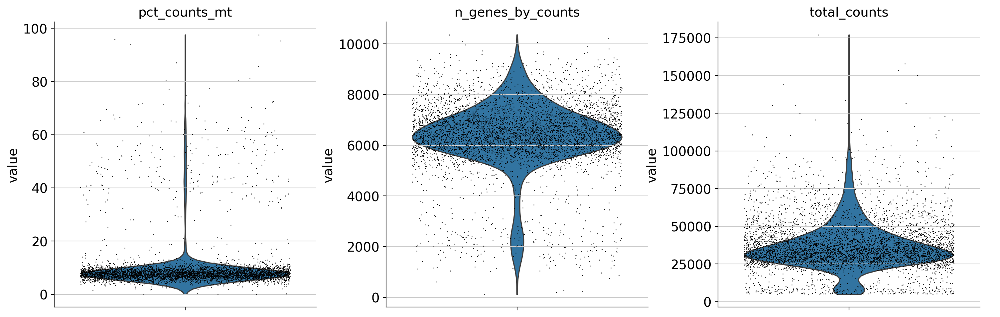

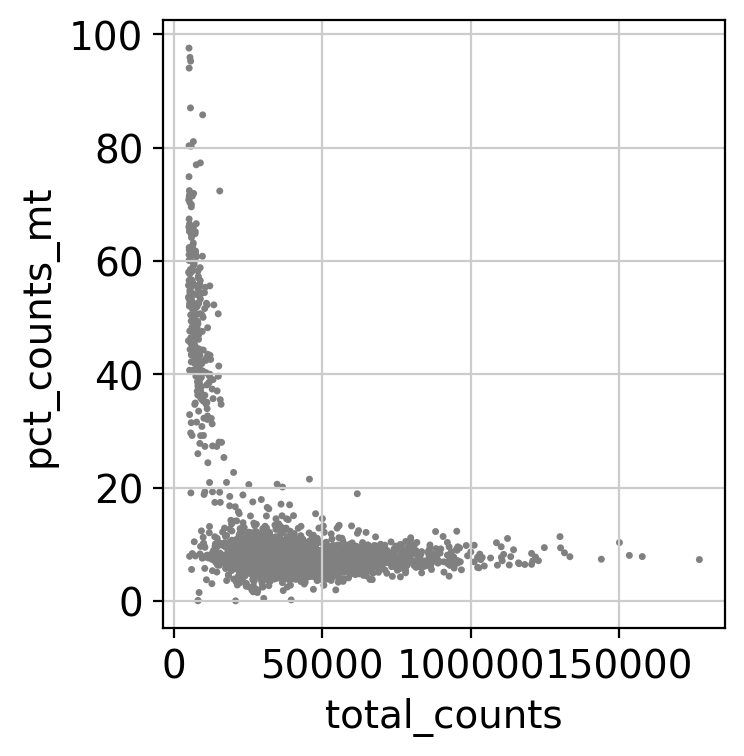

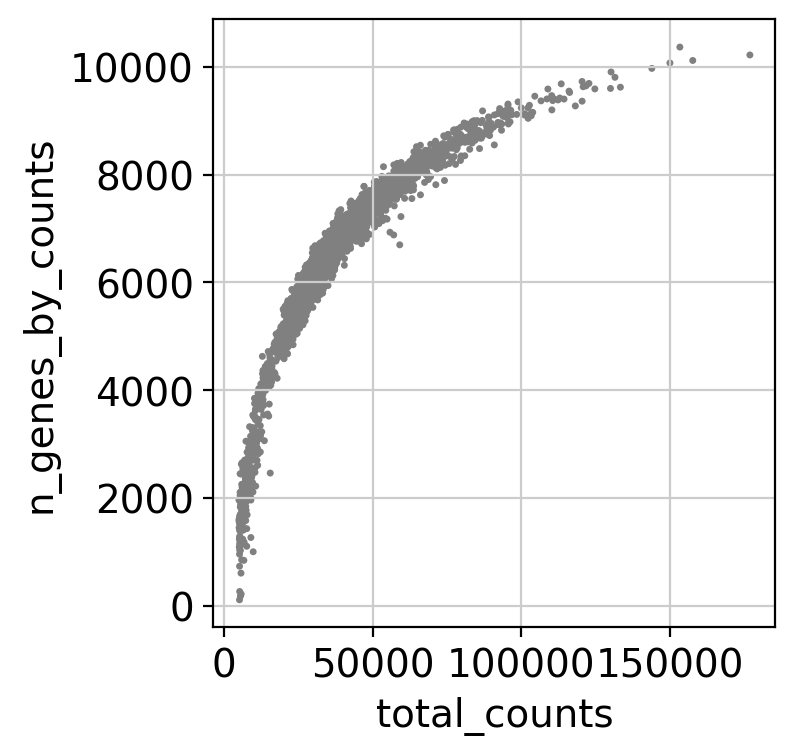

<Figure size 400x400 with 0 Axes>

In [9]:
sc.pl.violin(adata, ['pct_counts_mt', 'n_genes_by_counts', 'total_counts'], jitter=0.4, multi_panel=True)
sc.pl.scatter(adata, x='total_counts', y='pct_counts_mt')
sc.pl.scatter(adata, x='total_counts', y='n_genes_by_counts')
plt.savefig('7qc_metrics.png')

## 8. Filter Out Low-Quality Cells

### Purpose: Retain only high-quality cells using threshold-based filtering.

In [10]:
adata_filtered = adata[
    (adata.obs.n_genes_by_counts > 2500) &
    (adata.obs.n_genes_by_counts < 7500) &
    (adata.obs.total_counts > 10000) &
    (adata.obs.total_counts < 75000) &
    (adata.obs.pct_counts_mt < 15)
].copy()

## 9. Visualize Post-Filtering QC

### Purpose: Check the effect of filtering.

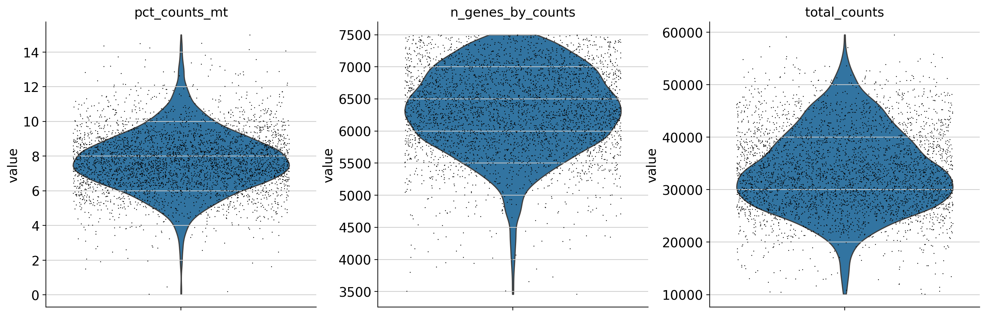

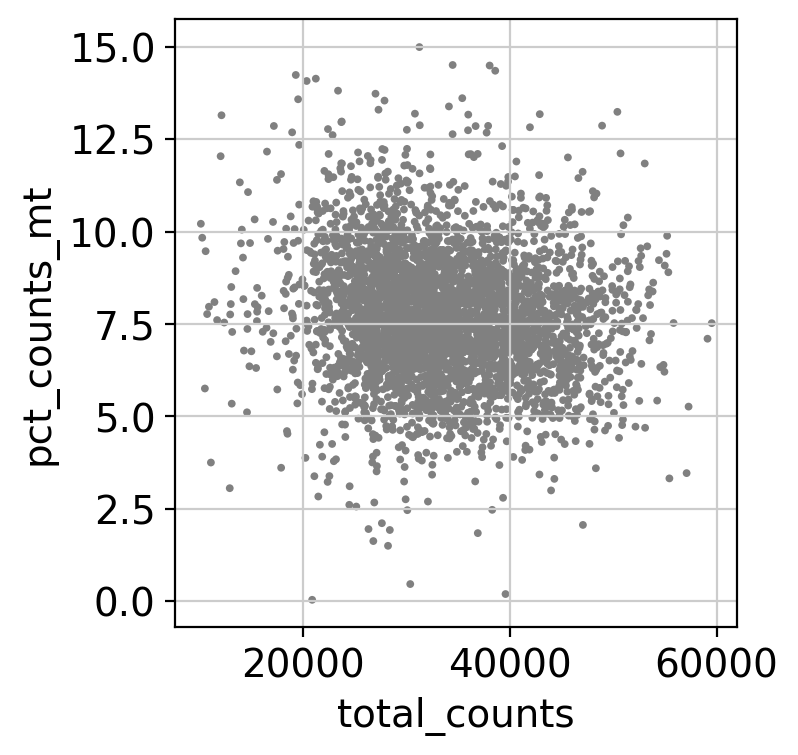

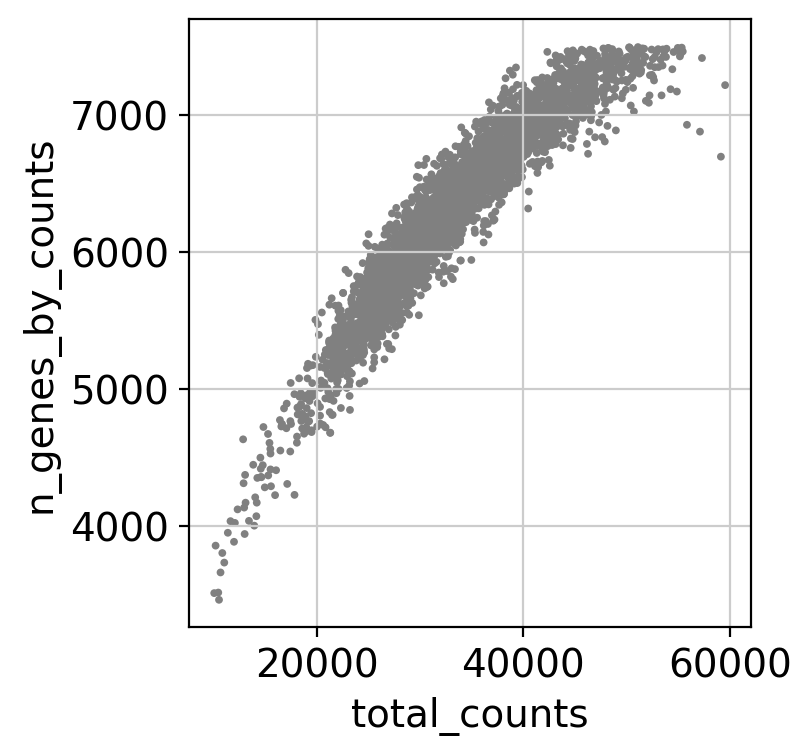

In [11]:
sc.pl.violin(adata_filtered, ['pct_counts_mt', 'n_genes_by_counts', 'total_counts'], jitter=0.4, multi_panel=True)
sc.pl.scatter(adata_filtered, x='total_counts', y='pct_counts_mt')
sc.pl.scatter(adata_filtered, x='total_counts', y='n_genes_by_counts')

## 10. Visualize Top Expressed Genes

### Purpose: Identify highly expressed genes across cells.

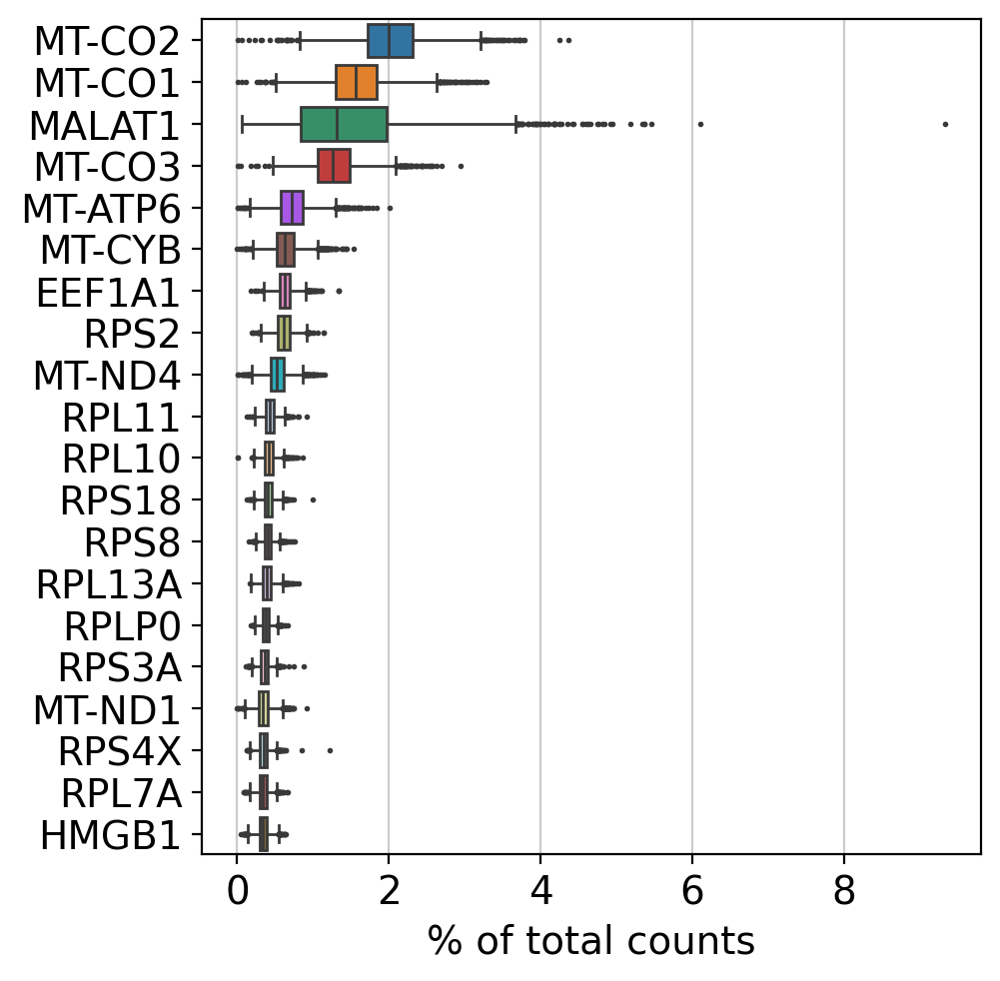

In [12]:
sc.pl.highest_expr_genes(adata_filtered, n_top=20)

## 11. Gene Annotation using MyGene.info

### Purpose: Add biological information (name, type, GO terms) to each gene.

In [13]:
from mygene import MyGeneInfo
mg = MyGeneInfo()

gene_info = mg.querymany(
    adata_filtered.var_names.tolist(),
    scopes="symbol",
    fields=["symbol", "name", "type_of_gene", "go", "summary"],
    species="human",
    returnall=True
)

gene_df = pd.DataFrame(gene_info['out']).drop_duplicates(subset=['query'], keep='first')
gene_df_indexed = pd.DataFrame(index=adata_filtered.var_names)
gene_df_indexed = gene_df_indexed.merge(gene_df.set_index('query'), left_index=True, right_index=True, how='left')
adata_filtered.var = gene_df_indexed

INFO:biothings.client:querying 1-1000 ...
INFO:biothings.client:querying 1001-2000 ...
INFO:biothings.client:querying 2001-3000 ...
INFO:biothings.client:querying 3001-4000 ...
INFO:biothings.client:querying 4001-5000 ...
INFO:biothings.client:querying 5001-6000 ...
INFO:biothings.client:querying 6001-7000 ...
INFO:biothings.client:querying 7001-8000 ...
INFO:biothings.client:querying 8001-9000 ...
INFO:biothings.client:querying 9001-10000 ...
INFO:biothings.client:querying 10001-11000 ...
INFO:biothings.client:querying 11001-12000 ...
INFO:biothings.client:querying 12001-13000 ...
INFO:biothings.client:querying 13001-13287 ...
INFO:biothings.client:Finished.


## 12. Preview Annotations

In [14]:
display(adata_filtered.var[['symbol', 'name', 'type_of_gene']].head(20))

,symbol,name,type_of_gene
AL669831.5,NaN,NaN,NaN
LINC00115,LINC00115,long intergenic non-protein coding RNA 115,NaN
FAM41C,FAM41C,family with sequence similarity 41 member C,ncRNA
AL645608.7,NaN,NaN,NaN
AL645608.3,NaN,NaN,NaN
AL645608.5,NaN,NaN,NaN
AL645608.1,NaN,NaN,NaN
SAMD11,SAMD11,sterile alpha motif domain containing 11,protein-coding
NOC2L,NOC2L,NOC2 like nucleolar associated transcriptional...,protein-coding
KLHL17,KLHL17,kelch like family member 17,protein-coding


## 13. Plot Gene Annotation Summary

### Purpose: Visualize annotation success (annotated vs unannotated genes).

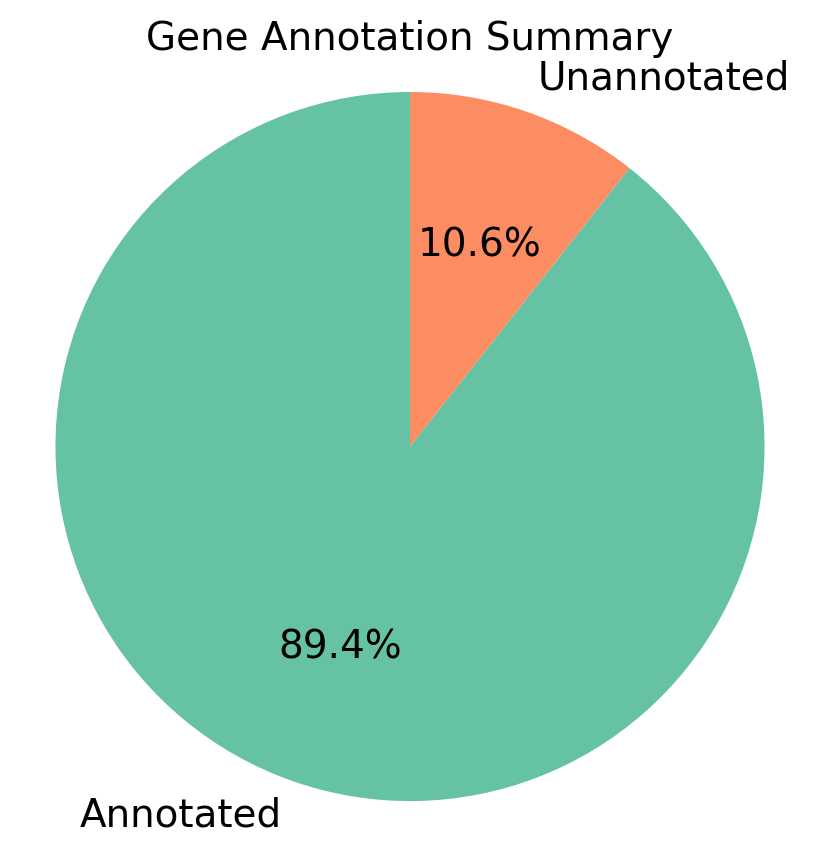

In [15]:
annotated_count = adata_filtered.var['name'].notna().sum()
unannotated_count = adata_filtered.var.shape[0] - annotated_count

plt.figure(figsize=(5, 5))
plt.pie([annotated_count, unannotated_count], labels=['Annotated', 'Unannotated'],
        colors=['#66c2a5', '#fc8d62'], autopct='%1.1f%%', startangle=90)
plt.title('Gene Annotation Summary')
plt.axis('equal')
plt.show()

## 14. Plot Gene Type Distribution

type_of_gene
protein-coding    11401
ncRNA               358
pseudo               16
other                 4
Name: count, dtype: int64


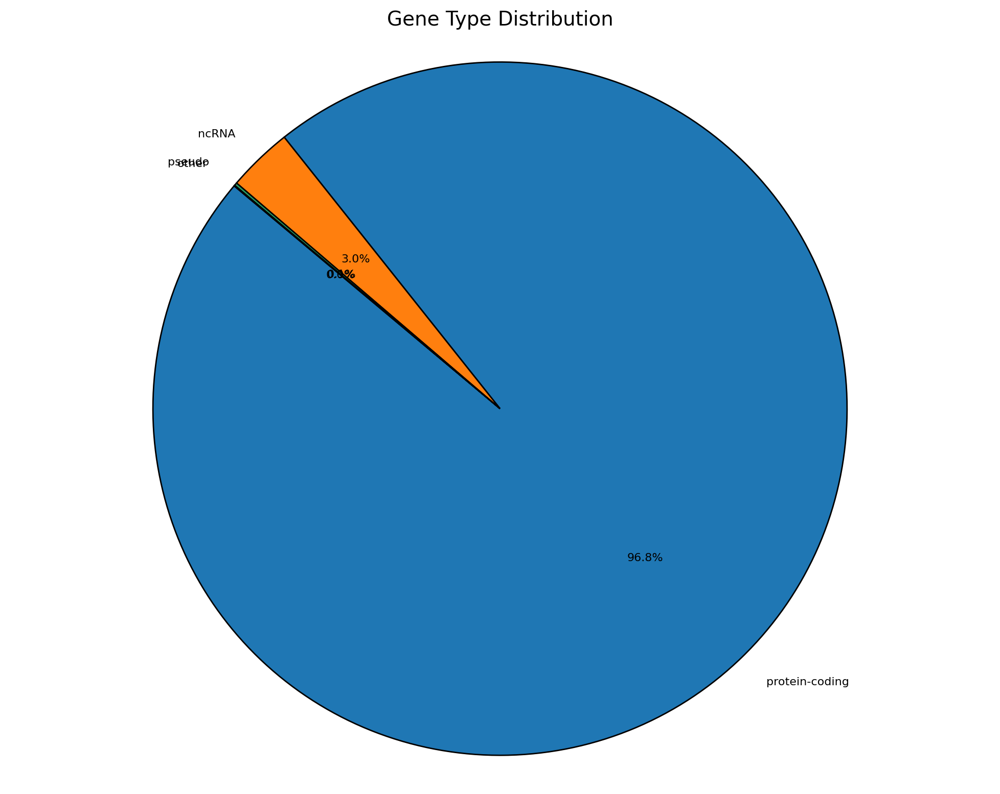

In [16]:
gene_type_counts = adata_filtered.var['type_of_gene'].dropna().value_counts()
print(gene_type_counts)

plt.figure(figsize=(10, 8))
plt.pie(gene_type_counts, labels=gene_type_counts.index, autopct='%1.1f%%',
        startangle=140, wedgeprops={'edgecolor': 'k'}, textprops={'fontsize': 8})
plt.title('Gene Type Distribution')
plt.axis('equal')
plt.tight_layout()
plt.show()

## 15. Prepare Data for SCVI

### Purpose: Initialize your AnnData object for deep learning modeling using scvi-tools.

In [17]:
# Setup AnnData for SCVI (required step before training)
scvi.model.SCVI.setup_anndata(adata_filtered)

## 16. Train the SCVI Model

### Purpose: Train a variational autoencoder to learn latent structure of the data.

In [18]:
# Initialize SCVI model
model = scvi.model.SCVI(adata_filtered)

# Train model with early stopping for efficiency
model.train(
    max_epochs=200,
    early_stopping=True,
    early_stopping_patience=20,
    early_stopping_monitor='elbo_validation'
)

INFO: GPU available: False, used: False
INFO:lightning.pytorch.utilities.rank_zero:GPU available: False, used: False
INFO: TPU available: False, using: 0 TPU cores
INFO:lightning.pytorch.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO: HPU available: False, using: 0 HPUs
INFO:lightning.pytorch.utilities.rank_zero:HPU available: False, using: 0 HPUs


Training:   0%|          | 0/200 [00:00<?, ?it/s]

INFO: `Trainer.fit` stopped: `max_epochs=200` reached.
INFO:lightning.pytorch.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=200` reached.


## 17. Save SCVI Latent Representation

### Purpose: Store the learned low-dimensional representation of each cell.

In [19]:
# Save latent space to AnnData object
adata_filtered.obsm["X_scVI"] = model.get_latent_representation()

## 18. UMAP Projection from SCVI Latent Space

### Purpose: Reduce dimensions for visualization using UMAP.

In [20]:
# Compute neighbors from SCVI latent space
sc.pp.neighbors(adata_filtered, use_rep="X_scVI")

# Run UMAP on the learned SCVI embedding
sc.tl.umap(adata_filtered)

## 19. Visualize UMAP

### Purpose: Explore your data in 2D.

Available metadata for plotting: ['n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', '_scvi_batch', '_scvi_labels']


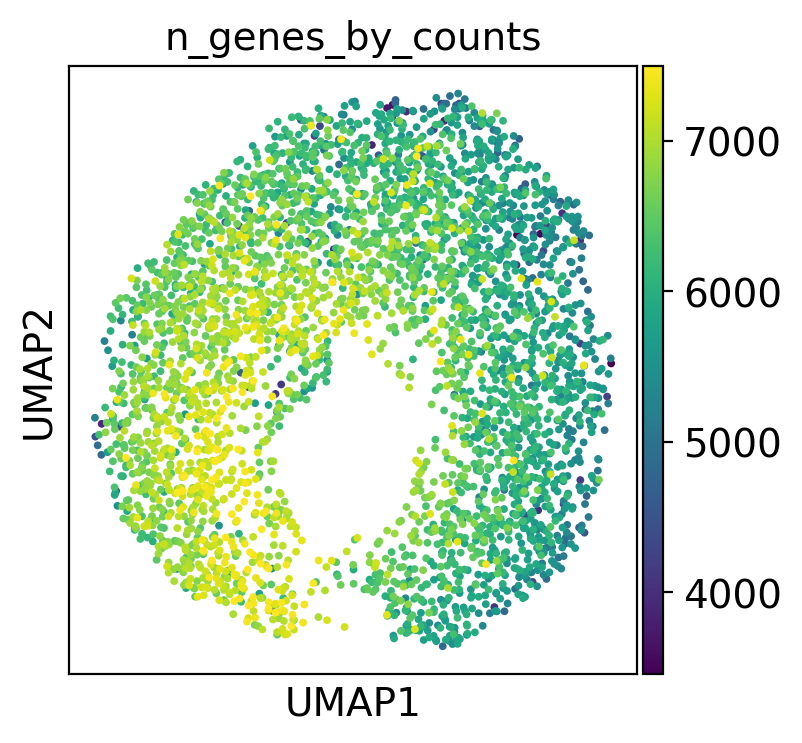

In [21]:
# Show available metadata fields
print("Available metadata for plotting:", adata_filtered.obs.columns.tolist())

# Plot UMAP (color by Leiden if available, fallback to other column)
sc.pl.umap(
    adata_filtered,
    color=["leiden" if "leiden" in adata_filtered.obs.columns else adata_filtered.obs.columns[0]],
    wspace=0.4
)
plt.show()

## 20. Leiden Clustering

### Purpose: Group cells based on similarity in the SCVI latent space.

In [22]:
# Perform clustering (resolution controls cluster granularity)
sc.tl.leiden(adata_filtered, resolution=0.6, random_state=0)

# Assign custom colors
cluster_colors = [
    "#e41a1c",  # red for cluster 0
    "#377eb8",  # blue for cluster 1
    "#4daf4a",  # green for cluster 2
    "#984ea3",  # purple for cluster 3
    "#ff7f00",  # orange for cluster 4
    "#ffff33",  # yellow for cluster 5
    "#a65628"   # brown for cluster 6
]
# Assign the color palette for Leiden clusters to adata_filtered.uns['leiden_colors']
# so that Scanpy plotting functions use these colors when visualizing the clusters.
adata_filtered.uns['leiden_colors'] = cluster_colors

/tmp/ipython-input-22-1190839451.py:2: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(adata_filtered, resolution=0.6, random_state=0)


## 21. Visualize Leiden Clusters on UMAP

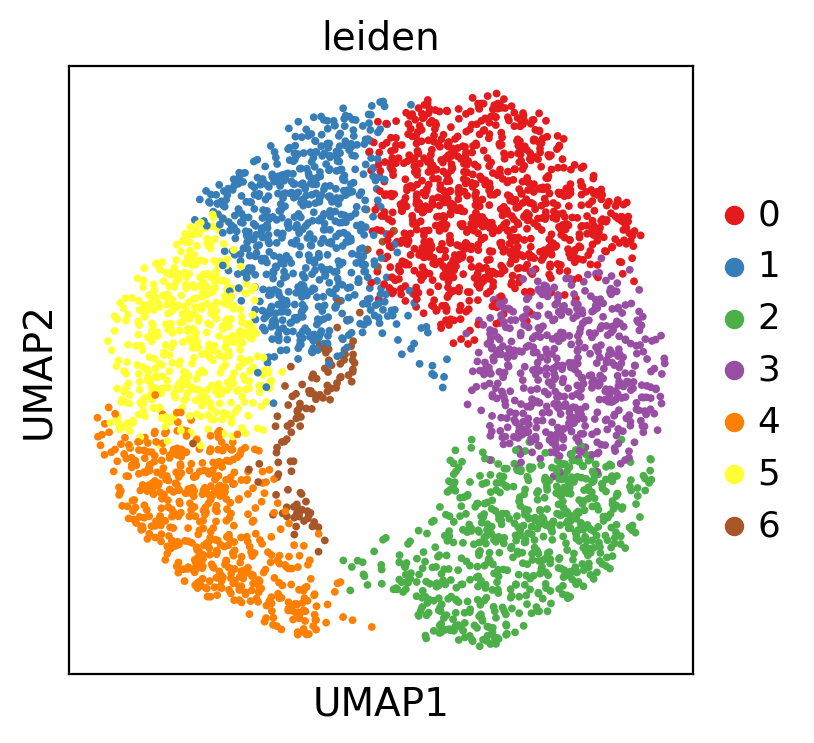

In [23]:
sc.pl.umap(adata_filtered, color='leiden')
plt.show()

## 22. Detect Marker Genes with SCVI (One-vs-Rest)

### Purpose: Identify top genes specific to each cluster.


In [24]:
clusters = adata_filtered.obs['leiden'].unique().tolist()
top_genes_scvi = {}

for cluster in clusters:
    print(f"Running DE for cluster {cluster} vs rest...")
    de_res = model.differential_expression(
        groupby='leiden',
        group1=cluster,
        group2=None  # one-vs-rest
    )

    # Filter significant genes by Bayes factor
    sig_genes = de_res[de_res['bayes_factor'] > 1].sort_values('bayes_factor', ascending=False)
    top_genes = sig_genes.index[:10].tolist()
    top_genes_scvi[cluster] = top_genes

    print(f"Top genes for cluster {cluster}: {top_genes}")

Running DE for cluster 0 vs rest...


DE...:   0%|          | 0/1 [00:00<?, ?it/s]

Top genes for cluster 0: ['MYT1L', 'EML1', 'NPY', 'NHSL1', 'CCER2', 'AL139424.1', 'DNAH10OS', 'LIMS2', 'SNED1', 'RHBDF2']
Running DE for cluster 2 vs rest...


DE...:   0%|          | 0/1 [00:00<?, ?it/s]

Top genes for cluster 2: ['DNAJB6', 'AC239868.3', 'RBBP6', 'AC008764.6', 'FOPNL', 'STAM-AS1', 'ZNF264', 'AC132192.2', 'TCTE3', 'AKIRIN1']
Running DE for cluster 6 vs rest...


DE...:   0%|          | 0/1 [00:00<?, ?it/s]

Top genes for cluster 6: ['CNTNAP2', 'PHGDH', 'FCGRT', 'A2M', 'OPRD1', 'CAMK1D', 'UBE2L6', 'EFHD1', 'CTSC', 'RGS16']
Running DE for cluster 4 vs rest...


DE...:   0%|          | 0/1 [00:00<?, ?it/s]

Top genes for cluster 4: ['FAM83D', 'PIF1', 'KIF18B', 'HYLS1', 'CDK1', 'AURKB', 'BORA', 'H2AFX', 'CCNF', 'CKAP2L']
Running DE for cluster 1 vs rest...


DE...:   0%|          | 0/1 [00:00<?, ?it/s]

Top genes for cluster 1: ['CCNE2', 'MCM10', 'E2F1', 'MASTL', 'ASF1B', 'TSEN54', 'FAM111B', 'TK1', 'CDC6', 'E2F2']
Running DE for cluster 3 vs rest...


DE...:   0%|          | 0/1 [00:00<?, ?it/s]

Top genes for cluster 3: ['NIPSNAP2', 'DARS', 'MRFAP1', 'LINC01249', 'AL161729.4', 'SRP72', 'CERS2', 'PDIA3', 'PCF11-AS1', 'GABRB2']
Running DE for cluster 5 vs rest...


DE...:   0%|          | 0/1 [00:00<?, ?it/s]

Top genes for cluster 5: ['NUP85', 'HIST1H4C', 'RRM2', 'HIST2H2AC', 'DEK', 'CDCA4', 'RRM1', 'CXADR', 'TYMS', 'PARP2']


## 23. Preview Marker Genes

In [25]:
print("Clusters:", top_genes_scvi.keys())
print("Example genes from cluster 0:", top_genes_scvi.get('0', []))

Clusters: dict_keys(['0', '2', '6', '4', '1', '3', '5'])
Example genes from cluster 0: ['MYT1L', 'EML1', 'NPY', 'NHSL1', 'CCER2', 'AL139424.1', 'DNAH10OS', 'LIMS2', 'SNED1', 'RHBDF2']


## 24. Plot Marker Genes on UMAP

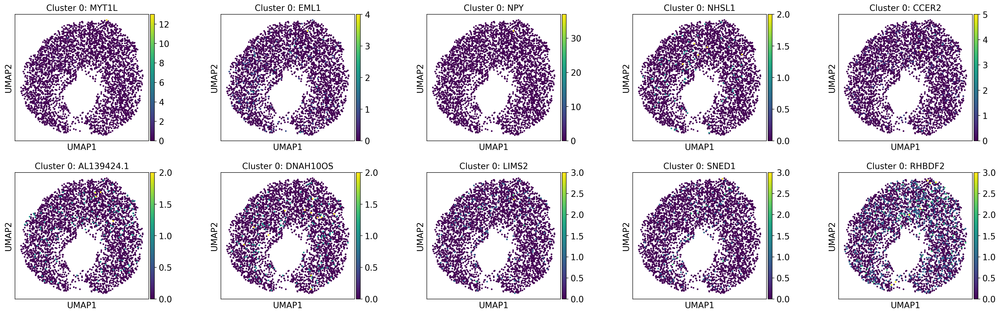

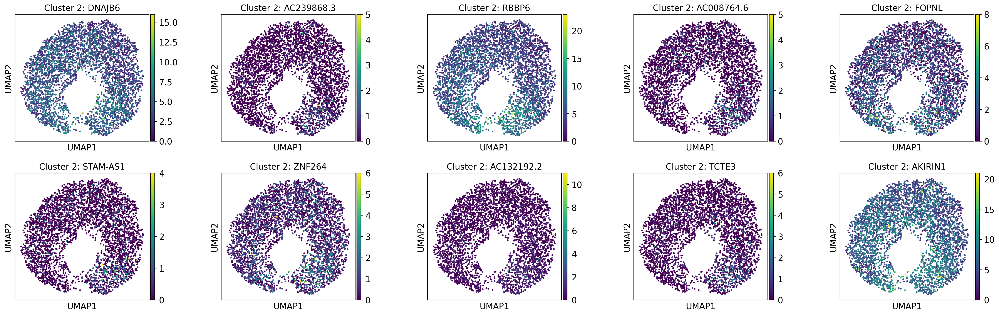

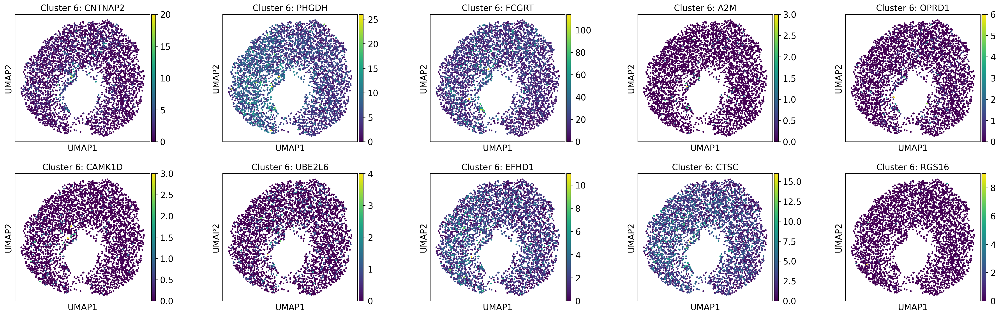

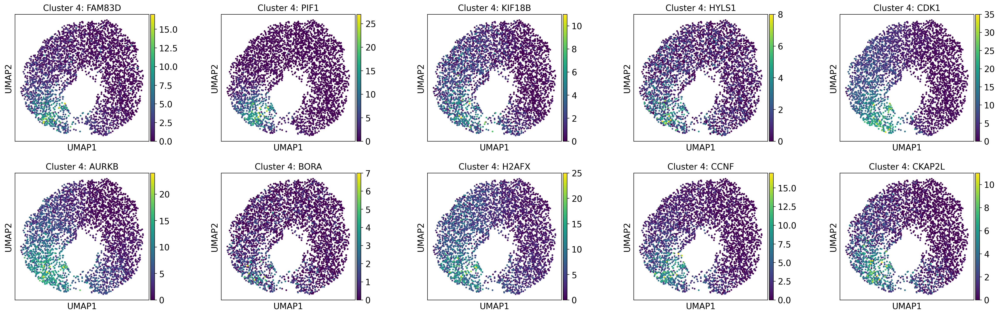

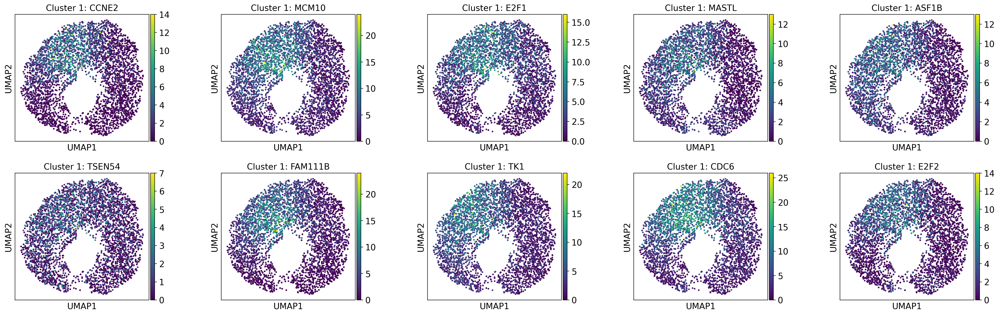

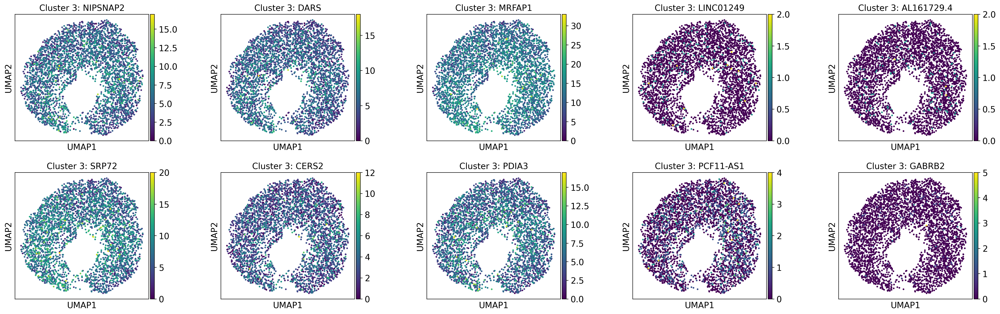

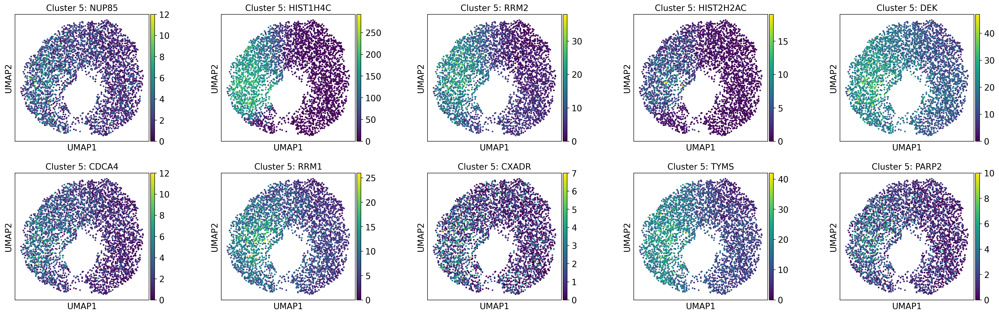

In [26]:
# UMAP gene expression for top markers per cluster
for cluster, genes in top_genes_scvi.items():
    if not genes:
        print(f"No marker genes found for cluster {cluster}, skipping.")
        continue
    sc.pl.umap(
        adata_filtered,
        color=genes,
        title=[f"Cluster {cluster}: {gene}" for gene in genes],
        ncols=5,
        wspace=0.4
    )


## 25. Dotplot for Marker Genes

dendrogram data not found (using key=dendrogram_leiden). Running `sc.tl.dendrogram` with default parameters. For fine tuning it is recommended to run `sc.tl.dendrogram` independently.
/usr/local/lib/python3.11/dist-packages/scanpy/tools/_dendrogram.py:138: UserWarning: You’re trying to run this on 13287 dimensions of `.X`, if you really want this, set `use_rep='X'`.
         Falling back to preprocessing with `sc.pp.pca` and default params.
  _choose_representation(adata, use_rep=use_rep, n_pcs=n_pcs)


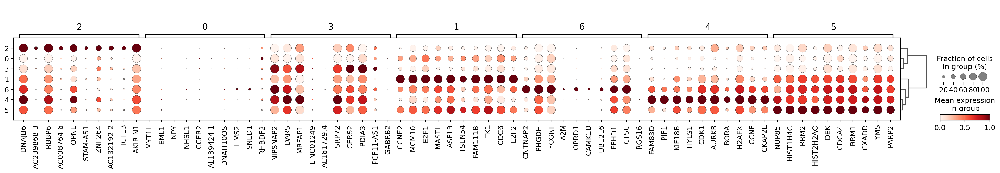

In [27]:
# Remove empty gene sets
top_genes_scvi_nonempty = {k: v for k, v in top_genes_scvi.items() if v}

# Plot all marker genes using dotplot
sc.pl.dotplot(
    adata_filtered,
    var_names=top_genes_scvi_nonempty,
    groupby="leiden",
    standard_scale="var",
    dendrogram=True
)

## 26. Dendrogram Based on SCVI Latent Space

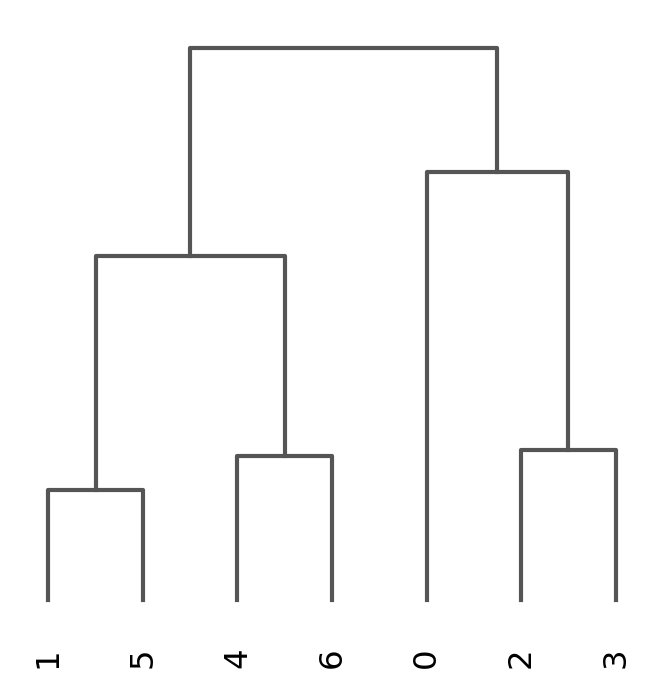

<Axes: >

In [28]:
# Compute and plot dendrogram
sc.tl.dendrogram(adata_filtered, groupby='leiden', use_rep='X_scVI')
sc.pl.dendrogram(adata_filtered, groupby='leiden')

## 27. Define Known Marker Gene Sets (e.g., Ewing Sarcoma)


In [29]:
marker_dict = {
    'Ewing_tumor': ['CD99', 'FLI1', 'EWSR1', 'NKX2-2'],
    'Cycling_cell': ['MKI67', 'TOP2A', 'PCNA'],
    'MSC_like': ['CD44', 'VCAM1', 'ENG'],
    'T_cell': ['CD3D', 'CD3E', 'IL7R'],
    'B_cell': ['CD79A', 'MS4A1', 'CD19'],
    'NK_cell': ['NKG7', 'GNLY', 'KLRD1'],
    'Monocyte': ['LYZ', 'S100A9', 'CD14'],
    'Dendritic_cell': ['FCER1A', 'CD1C', 'CLEC9A'],
    'Endothelial': ['PECAM1', 'VWF', 'CD34'],
    'Fibroblast': ['DCN', 'COL1A1', 'ACTA2'],
    'Immune_evasion': ['B2M', 'TGFBI', 'CD47', 'SERPINB9'],
    'antitumor_genes': ['G2MB', 'PRF1', 'IFNG', 'GNLY', 'NKG7']
}


## 28. Filter Missing Marker Genes

In [30]:
# Remove genes that are not found in the dataset
all_marker_genes = [gene for genes in marker_dict.values() for gene in genes]
missing_genes = [g for g in all_marker_genes if g not in adata_filtered.var_names]
print("Missing genes:", missing_genes)

filtered_marker_dict = {
    label: [gene for gene in genes if gene in adata_filtered.var_names]
    for label, genes in marker_dict.items()
}
filtered_marker_dict = {k: v for k, v in filtered_marker_dict.items() if v}
print("Final marker categories:", filtered_marker_dict.keys())

Missing genes: ['CD44', 'CD3D', 'CD3E', 'IL7R', 'MS4A1', 'NKG7', 'GNLY', 'KLRD1', 'LYZ', 'S100A9', 'CD14', 'FCER1A', 'CD1C', 'CLEC9A', 'PECAM1', 'VWF', 'CD34', 'TGFBI', 'G2MB', 'PRF1', 'IFNG', 'GNLY', 'NKG7']
Final marker categories: dict_keys(['Ewing_tumor', 'Cycling_cell', 'MSC_like', 'B_cell', 'Fibroblast', 'Immune_evasion'])


## 29. Dotplot for Known Marker Genes

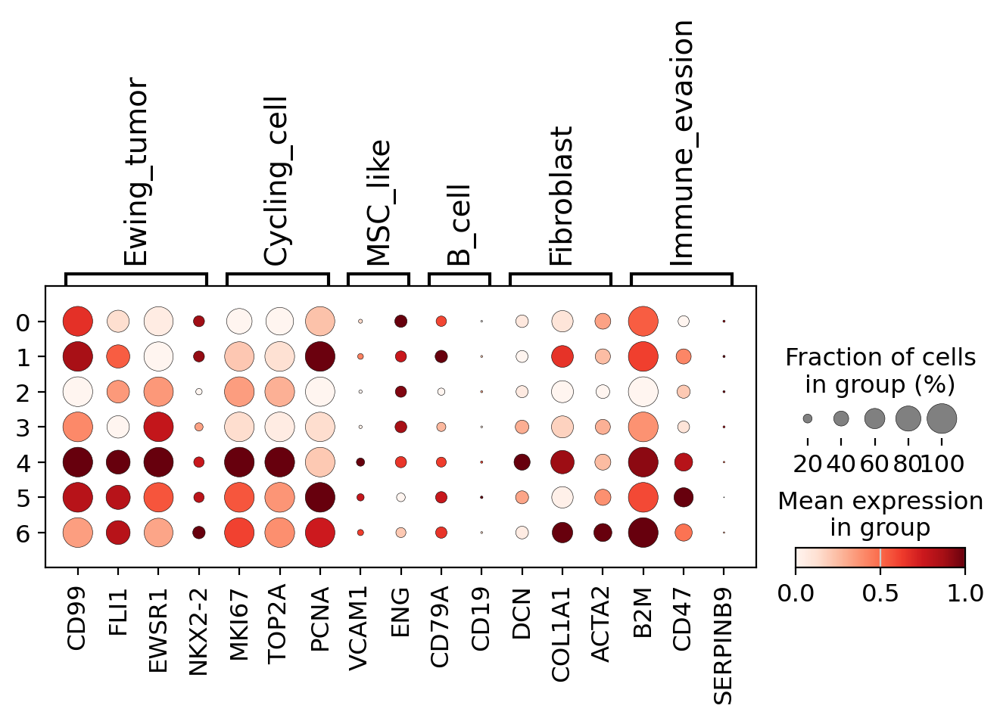

In [31]:
# Visualize known marker expression across clusters
sc.pl.dotplot(
    adata_filtered,
    var_names=filtered_marker_dict,
    groupby='leiden',
    standard_scale='var',
    use_raw=False
)

## 30. UMAP of Known Marker Genes

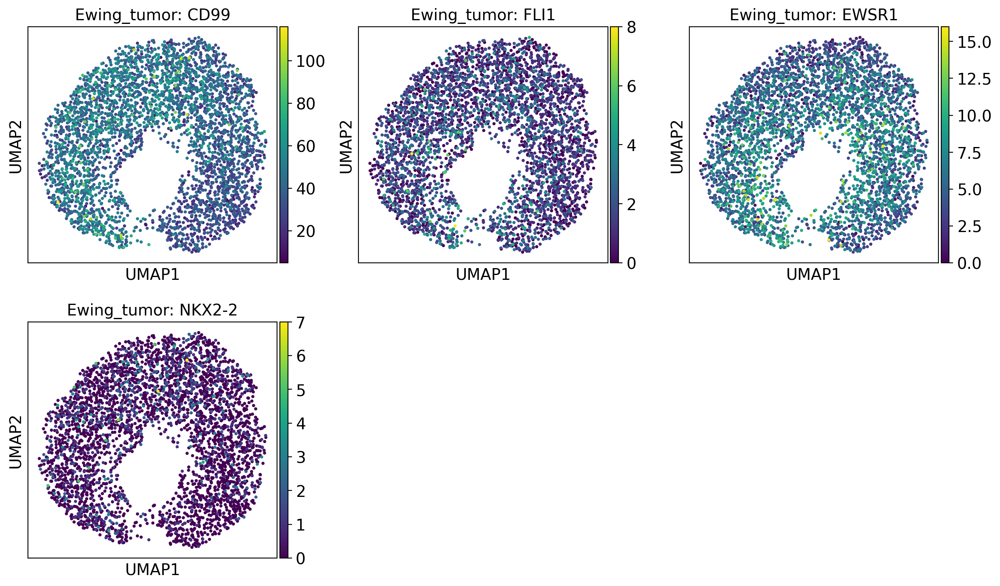

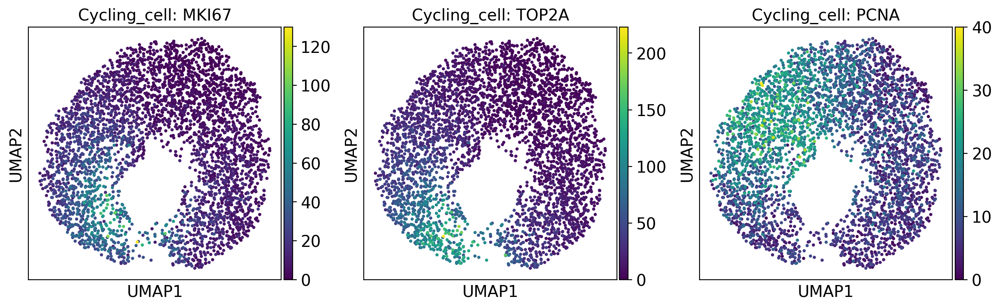

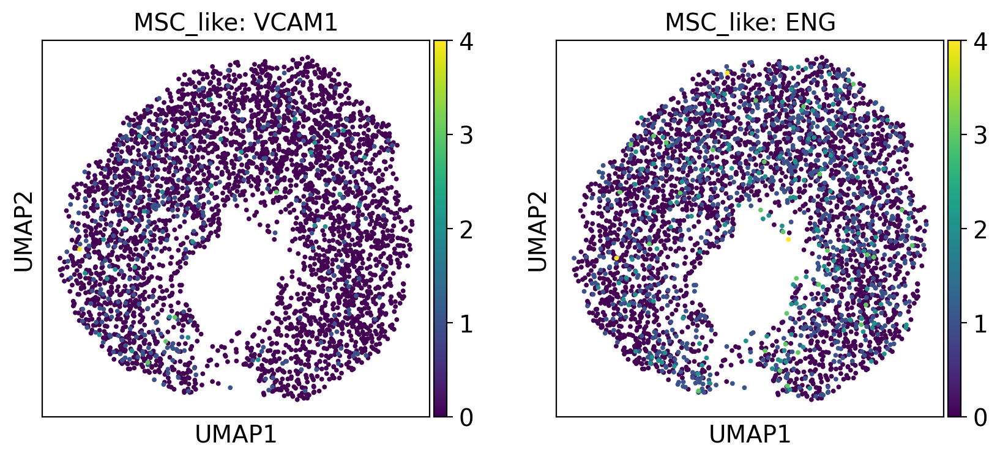

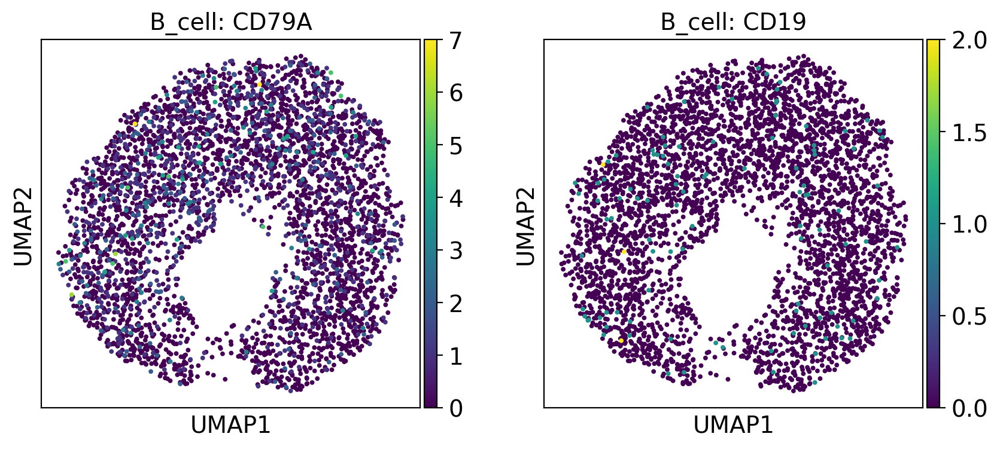

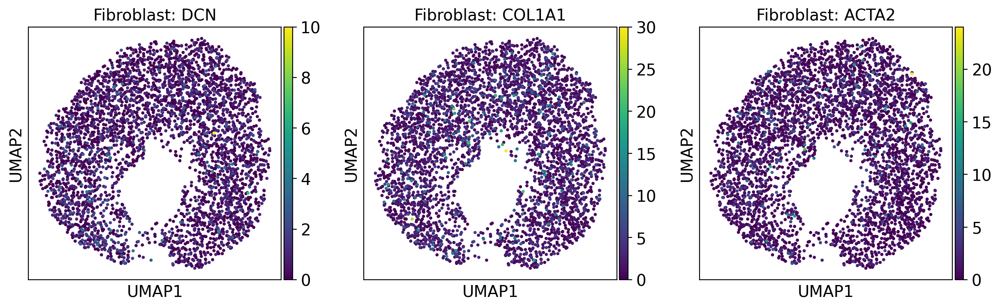

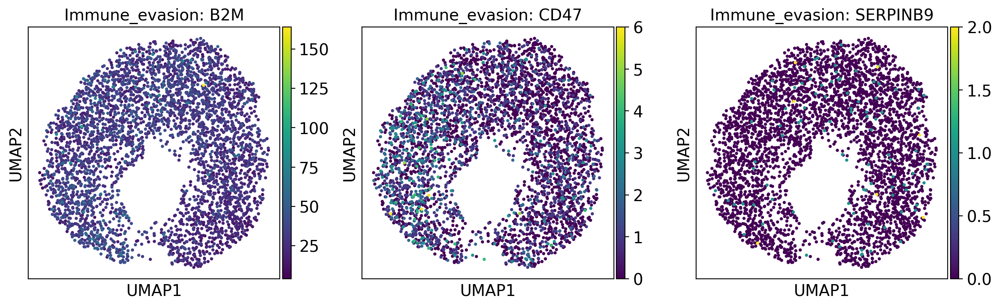

In [32]:
# Show known markers on UMAP
for label, genes in filtered_marker_dict.items():
    sc.pl.umap(
        adata_filtered,
        color=genes,
        title=[f"{label}: {gene}" for gene in genes],
        ncols=3
    )
